# Geog5995 Final Project - Explore Correlations between Leeds Crime and Priority Place for Food Index Data by Yang Yi

This Jupeter Notebook is designed for Google Colab users only, modification and adjust to code sections are required if it runs in non-Colab environment.

We will go through data preparation, merge, clean up and correlation analysis between crime and food PPFI in Leeds.

# Data Preparation


## Crime Data Download and Merge

Download West Yorkshire Policy crime data between April 2023 and March 2024 from https://data.police.uk/data/, and put them under "data" folder in GitHub file system

Since the data is separated to multiple files, the first step is to merge it to together, merge_data.py is created to do the work.

### merge_data.py code snippet

```
import os
import pandas as pd

# open the directory and view its contents
data_dir = os.listdir(os.getcwd() + '/data')

# create a list to store pandas data frames for csv data files
df_list = []

# loop the contents of the directory
for data_file in data_dir:
    
    print(data_file)
    
    # skip lines that fail to parse and put the dataframe into df_list
    df_list.append(pd.read_csv('data/' + data_file, error_bad_lines=False))

# concatenate data frames vertically
concatenated_df = pd.concat(df_list)

# save data frame to CSV file
concatenated_df.to_csv('west-yorkshire-street-merged.csv', index=False)
```

Please navigate to the right directory and use "python merge_data.py" to merge multiple crime data files into a single one. Or just use the "west-yorkshire-street-merged.csv" file from GitHub repository in the following notes.

## Import Python Libraries

In [4]:
# import required packages
import geopandas as gpd
import pandas as pd
import seaborn as sns
from scipy import stats
import numpy as np

import matplotlib.pyplot as plt

# import the required machine learning packages
from sklearn import cluster
from sklearn.preprocessing import scale

# set seaborn plotting theme to white
sns.set_theme(style="white")

In [5]:
# colab users only - uncomment to run
!pip install mapclassify

## Crime Data Cleanup

First let's upload the crime data file to Colab, run the following code and select the "west-yorkshire-street-merged.csv" file from your file system.

In [6]:
from google.colab import files

# open file upload west-yorkshire-street-merged.csv file
uploaded = files.upload()

Saving west-yorkshire-street-merged.csv to west-yorkshire-street-merged.csv


In [7]:

import io

# read csv with pandas
crime = pd.read_csv(io.BytesIO(uploaded[next(iter(uploaded))]))

In [8]:
crime.head()

,Crime ID,Month,Reported by,Falls within,Longitude,Latitude,Location,LSOA code,LSOA name,Crime type,Last outcome category,Context
0,NaN,2023-04,West Yorkshire Police,West Yorkshire Police,-1.472961,53.599861,On or near Railway Walk,E01007439,Barnsley 001D,Anti-social behaviour,NaN,NaN
1,017f9a1d76cb1c6219a20ede9167f64985b6761dde8c92...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.356632,53.589279,On or near Common Road,E01007328,Barnsley 006A,Public order,Investigation complete; no suspect identified,NaN
2,21a4234e31c132ebb79b6b5f14f8843d87f630ad1b0501...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.874034,53.943667,On or near Beacon Street,E01010646,Bradford 001A,Criminal damage and arson,Unable to prosecute suspect,NaN
3,424a99214b8a58bda370a2f84a8aecfa022a47b41463e2...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.878940,53.943744,On or near Cross End Fold,E01010646,Bradford 001A,Shoplifting,Investigation complete; no suspect identified,NaN
4,b78a4efaec313f85b2bde1d0d200ee133da9c47e59753e...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.874034,53.943667,On or near Beacon Street,E01010646,Bradford 001A,Violence and sexual offences,Unable to prosecute suspect,NaN


Notice that the column names contains space, let's convert them to programming friendly column names.

In [9]:
# replace space with "_"
crime.columns = crime.columns.str.replace(' ', '_')
# change to lower letters
crime.columns = crime.columns.str.lower()
# check it again
crime.head()

,crime_id,month,reported_by,falls_within,longitude,latitude,location,lsoa_code,lsoa_name,crime_type,last_outcome_category,context
0,NaN,2023-04,West Yorkshire Police,West Yorkshire Police,-1.472961,53.599861,On or near Railway Walk,E01007439,Barnsley 001D,Anti-social behaviour,NaN,NaN
1,017f9a1d76cb1c6219a20ede9167f64985b6761dde8c92...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.356632,53.589279,On or near Common Road,E01007328,Barnsley 006A,Public order,Investigation complete; no suspect identified,NaN
2,21a4234e31c132ebb79b6b5f14f8843d87f630ad1b0501...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.874034,53.943667,On or near Beacon Street,E01010646,Bradford 001A,Criminal damage and arson,Unable to prosecute suspect,NaN
3,424a99214b8a58bda370a2f84a8aecfa022a47b41463e2...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.878940,53.943744,On or near Cross End Fold,E01010646,Bradford 001A,Shoplifting,Investigation complete; no suspect identified,NaN
4,b78a4efaec313f85b2bde1d0d200ee133da9c47e59753e...,2023-04,West Yorkshire Police,West Yorkshire Police,-1.874034,53.943667,On or near Beacon Street,E01010646,Bradford 001A,Violence and sexual offences,Unable to prosecute suspect,NaN


Explore the dataset a little bit

In [10]:
# check crime dataframe info
crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 321552 entries, 0 to 321551
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   crime_id               294221 non-null  object 
 1   month                  321552 non-null  object 
 2   reported_by            321552 non-null  object 
 3   falls_within           321552 non-null  object 
 4   longitude              316978 non-null  float64
 5   latitude               316978 non-null  float64
 6   location               321552 non-null  object 
 7   lsoa_code              316978 non-null  object 
 8   lsoa_name              316978 non-null  object 
 9   crime_type             321552 non-null  object 
 10  last_outcome_category  294221 non-null  object 
 11  context                0 non-null       float64
dtypes: float64(3), object(9)
memory usage: 29.4+ MB


We want to get crime numbers in Leeds, thus lsoa_code, crime_type these two columns should have non-null values, let's remove the rows which don't have values in these two columns.

In [11]:
# remove rows with null values in lsoa_code and crime_type
crime_cleaned = crime.dropna(subset=['lsoa_code', 'crime_type'])

# check dataframe info
crime_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 316978 entries, 0 to 321200
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   crime_id               289893 non-null  object 
 1   month                  316978 non-null  object 
 2   reported_by            316978 non-null  object 
 3   falls_within           316978 non-null  object 
 4   longitude              316978 non-null  float64
 5   latitude               316978 non-null  float64
 6   location               316978 non-null  object 
 7   lsoa_code              316978 non-null  object 
 8   lsoa_name              316978 non-null  object 
 9   crime_type             316978 non-null  object 
 10  last_outcome_category  289893 non-null  object 
 11  context                0 non-null       float64
dtypes: float64(3), object(9)
memory usage: 31.4+ MB


Now all 316978 rows have values in lsoa_code and crime_type columns, next we will aggregate to get the crime count for each lsoa_code and crime_type combination.

In [12]:
# group by "lsoa_code" and "crime_type" to get crime count for each lsoa_code and crime_type combination
crime_counts = crime_cleaned.groupby(['lsoa_code', 'crime_type']).size().reset_index(name='crime_count')
# check data
crime_counts.head()

,lsoa_code,crime_type,crime_count
0,E01005410,Anti-social behaviour,1
1,E01005410,Violence and sexual offences,1
2,E01005414,Violence and sexual offences,1
3,E01005561,Drugs,1
4,E01007328,Anti-social behaviour,1


Then use pivot_table method in pandas to convert unique values in 'crime_type' column into separate columns.

In [13]:
# convert unique values to dataframe columns with pivot_table method
crime_pivot = crime_counts.pivot_table(index='lsoa_code', columns='crime_type', values='crime_count', aggfunc='sum')
# check result
crime_pivot.head()

crime_type,Anti-social behaviour,Bicycle theft,Burglary,Criminal damage and arson,Drugs,Other crime,Other theft,Possession of weapons,Public order,Robbery,Shoplifting,Theft from the person,Vehicle crime,Violence and sexual offences
lsoa_code,,,,,,,,,,,,,,
E01005410,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
E01005414,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
E01005561,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
E01007328,1.0,NaN,NaN,NaN,1.0,NaN,1.0,NaN,2.0,NaN,NaN,NaN,NaN,1.0
E01007355,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


Remove space in columns names and convert to lower letters

In [14]:
# replace space with "_"
crime_pivot.columns = crime_pivot.columns.str.replace(' ', '_')
# change to lower letters
crime_pivot.columns = crime_pivot.columns.str.lower()
# check it again
crime_pivot.head()

crime_type,anti-social_behaviour,bicycle_theft,burglary,criminal_damage_and_arson,drugs,other_crime,other_theft,possession_of_weapons,public_order,robbery,shoplifting,theft_from_the_person,vehicle_crime,violence_and_sexual_offences
lsoa_code,,,,,,,,,,,,,,
E01005410,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
E01005414,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
E01005561,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
E01007328,1.0,NaN,NaN,NaN,1.0,NaN,1.0,NaN,2.0,NaN,NaN,NaN,NaN,1.0
E01007355,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


Now let's drop the 'crime_type' column and fill NaN values with 0

In [15]:
# reset index of the crime_pivot dataframe
final_crime_df = crime_pivot.reset_index()
# fill NaN with 0
final_crime_df.fillna(0, inplace=True)
# delete columns.name
final_crime_df.columns.name = None
# check the value
final_crime_df.head()

,lsoa_code,anti-social_behaviour,bicycle_theft,burglary,criminal_damage_and_arson,drugs,other_crime,other_theft,possession_of_weapons,public_order,robbery,shoplifting,theft_from_the_person,vehicle_crime,violence_and_sexual_offences
0,E01005410,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,E01005414,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,E01005561,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,E01007328,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0
4,E01007355,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [16]:
final_crime_df.columns

Index(['lsoa_code', 'anti-social_behaviour', 'bicycle_theft', 'burglary',
       'criminal_damage_and_arson', 'drugs', 'other_crime', 'other_theft',
       'possession_of_weapons', 'public_order', 'robbery', 'shoplifting',
       'theft_from_the_person', 'vehicle_crime',
       'violence_and_sexual_offences'],
      dtype='object')

## Join Crime Data with Leeds SHP Data

Leeds SHP data is from our lecture note.

In [17]:
from google.colab import files

# open the file upload dialog and upload Leeds.geojson
uploaded = files.upload()

Saving Leeds.geojson to Leeds.geojson


In [18]:
# read Leeds.geojson file
leeds_shp = gpd.read_file(io.BytesIO(uploaded[next(iter(uploaded))]))
# check its data
leeds_shp

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry
0,10720,E01011264,Leeds 011A,420937,441836,-1.68306,53.87232,14a73329-fc8f-464c-a4fa-1963baa35500,"POLYGON ((421248.688 442315.812, 421284.073 44..."
1,10721,E01011265,Leeds 009A,418988,441951,-1.71269,53.87343,eda471dd-f408-4dab-917e-c5e188310b35,"POLYGON ((418635.000 442559.000, 418637.555 44..."
2,10722,E01011266,Leeds 008A,417489,442615,-1.73545,53.87945,286c32c5-ef49-4ecc-a45e-57630c165c62,"POLYGON ((417783.688 443382.312, 417788.688 44..."
3,10723,E01011267,Leeds 009B,419641,442025,-1.70276,53.87407,318cfaa3-9f08-4d61-a30e-82e903f3a7ba,"POLYGON ((419607.843 442388.568, 419612.752 44..."
4,10724,E01011268,Leeds 010A,420224,441935,-1.69390,53.87324,049e79f0-cd9e-47dc-848b-b6d6fa6825ac,"POLYGON ((420442.406 442436.687, 420443.313 44..."
...,...,...,...,...,...,...,...,...,...
483,33045,E01035050,Leeds 105G,430214,426790,-1.54344,53.73664,b667dd4b-08ca-44db-9dda-151975c865fc,"POLYGON ((430986.896 427756.226, 430982.739 42..."
484,33046,E01035051,Leeds 105H,431335,427174,-1.52641,53.74003,1f70231e-7d95-4348-8af5-93b39135f194,"POLYGON ((431044.305 427760.241, 431050.502 42..."
485,33047,E01035052,Leeds 105I,431014,426532,-1.53134,53.73427,5f1e5ab8-2aec-4af0-9271-558e556b63ba,"POLYGON ((431312.508 427066.000, 431277.221 42..."
486,33048,E01035053,Leeds 105J,432010,426253,-1.51627,53.73171,0be7990f-f591-4c6c-953b-adc431b812da,"POLYGON ((432234.698 427047.143, 432235.065 42..."


In [19]:
# join the crime data to the leeds_shp geodataframe using a lefthand join, on the common ID 'LSOA21CD'/'lsoa_code'
leeds_crime = leeds_shp.merge(final_crime_df, how='left',left_on='LSOA21CD',right_on='lsoa_code')

In [20]:
# check its data
leeds_crime.head()

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,lsoa_code,...,drugs,other_crime,other_theft,possession_of_weapons,public_order,robbery,shoplifting,theft_from_the_person,vehicle_crime,violence_and_sexual_offences
0,10720,E01011264,Leeds 011A,420937,441836,-1.68306,53.87232,14a73329-fc8f-464c-a4fa-1963baa35500,"POLYGON ((421248.688 442315.812, 421284.073 44...",E01011264,...,1.0,6.0,2.0,0.0,10.0,1.0,0.0,0.0,8.0,32.0
1,10721,E01011265,Leeds 009A,418988,441951,-1.71269,53.87343,eda471dd-f408-4dab-917e-c5e188310b35,"POLYGON ((418635.000 442559.000, 418637.555 44...",E01011265,...,4.0,7.0,18.0,2.0,40.0,9.0,48.0,3.0,12.0,91.0
2,10722,E01011266,Leeds 008A,417489,442615,-1.73545,53.87945,286c32c5-ef49-4ecc-a45e-57630c165c62,"POLYGON ((417783.688 443382.312, 417788.688 44...",E01011266,...,2.0,3.0,12.0,1.0,19.0,1.0,12.0,1.0,15.0,56.0
3,10723,E01011267,Leeds 009B,419641,442025,-1.70276,53.87407,318cfaa3-9f08-4d61-a30e-82e903f3a7ba,"POLYGON ((419607.843 442388.568, 419612.752 44...",E01011267,...,1.0,8.0,17.0,1.0,23.0,0.0,0.0,1.0,10.0,112.0
4,10724,E01011268,Leeds 010A,420224,441935,-1.69390,53.87324,049e79f0-cd9e-47dc-848b-b6d6fa6825ac,"POLYGON ((420442.406 442436.687, 420443.313 44...",E01011268,...,6.0,7.0,5.0,0.0,18.0,1.0,6.0,0.0,6.0,85.0


## Further Join with Food PPFI data

Food PPFI data is from our lecture note and we use it to join with crime data for further exploration.

In [21]:
from google.colab import files

# open the file upload dialog and upload ppfi_index_v2_nov2023.csv
uploaded = files.upload()

Saving ppfi_index_v2_nov2023.csv to ppfi_index_v2_nov2023.csv


In [22]:
import io

# read ppfi_index_v2_nov2023.csv file
PPFI = pd.read_csv(io.BytesIO(uploaded[next(iter(uploaded))]))

In [23]:
# join PPFI with leeds_crime dataframe on lsoa_code/lsoa21cd columns
leeds_crime_with_ppfi = leeds_crime.merge(PPFI, how='left',left_on='lsoa_code',right_on='lsoa21cd')

# Crime and Food PPFI Correlation Analysis

First let's explore a random crime type, we choose "violence_and_sexual_offences" here

In [24]:
# explore violence_and_sexual_offences on the map, use quantiles scheme to make
# color more profound
leeds_crime_with_ppfi.explore('violence_and_sexual_offences', cmap='Reds', scheme='quantiles')

In [25]:
# display dataframe information
leeds_crime_with_ppfi.info()

Let's further plot each crime data on the map


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 488 entries, 0 to 487
Data columns (total 43 columns):
 #   Column                                   Non-Null Count  Dtype   
---  ------                                   --------------  -----   
 0   FID                                      488 non-null    int64   
 1   LSOA21CD                                 488 non-null    object  
 2   LSOA21NM                                 488 non-null    object  
 3   BNG_E                                    488 non-null    int64   
 4   BNG_N                                    488 non-null    int64   
 5   LONG                                     488 non-null    float64 
 6   LAT                                      488 non-null    float64 
 7   GlobalID                                 488 non-null    object  
 8   geometry                                 488 non-null    geometry
 9   lsoa_code                                488 non-null    object  
 10  anti-social_behaviour         

/usr/local/lib/python3.10/dist-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 4.
  self.bins = quantile(y, k=k)
/usr/local/lib/python3.10/dist-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 4.
  self.bins = quantile(y, k=k)
/usr/local/lib/python3.10/dist-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 4.
  self.bins = quantile(y, k=k)
/usr/local/lib/python3.10/dist-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 5 classes. Setting k to 4.
  self.bins = quantile(y, k=k)


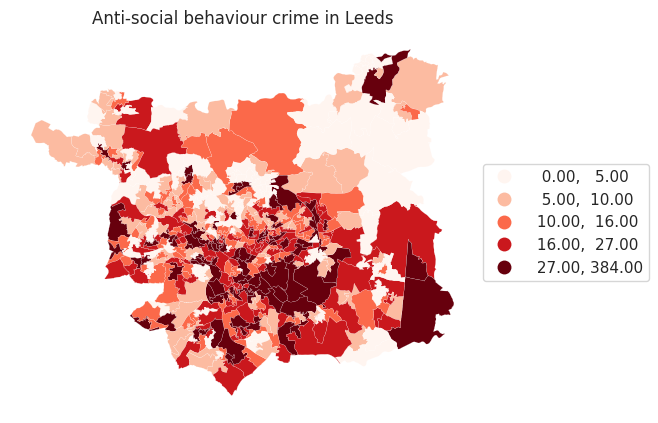

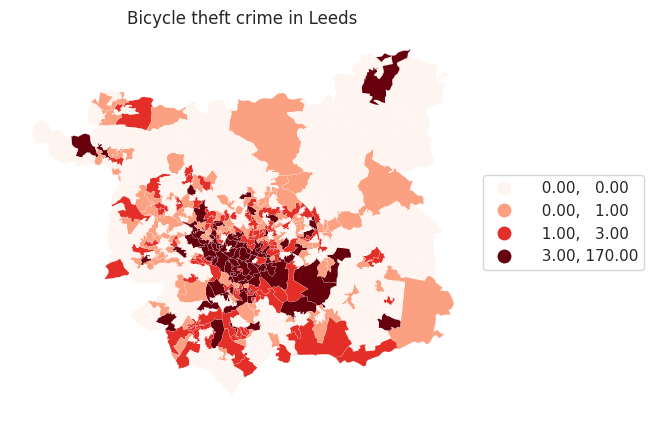

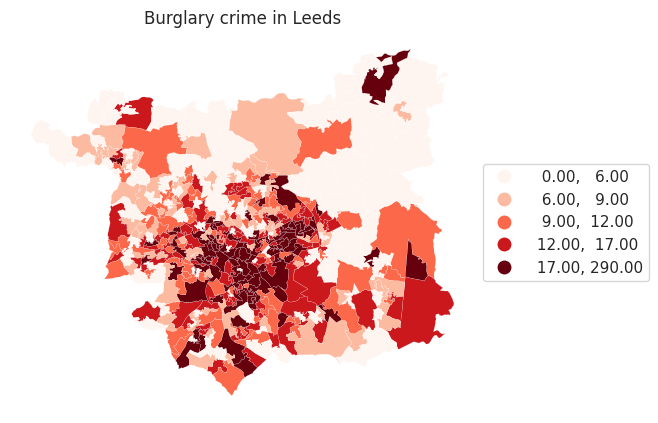

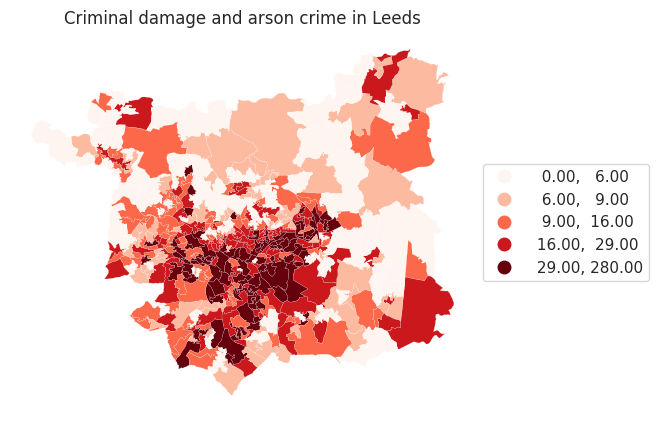

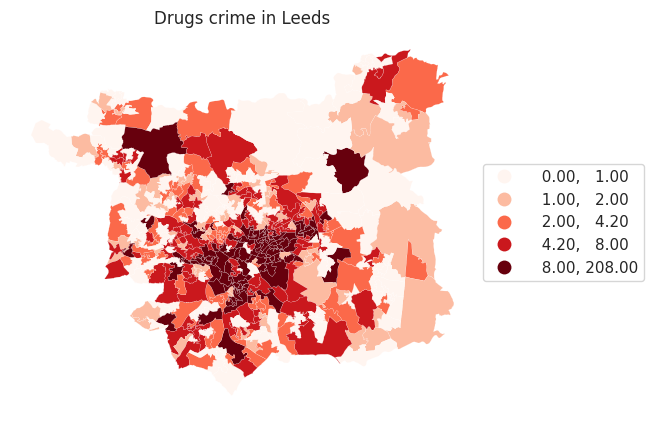

...

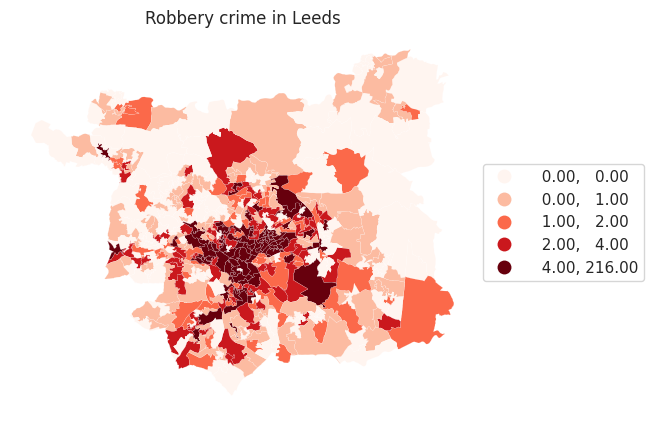

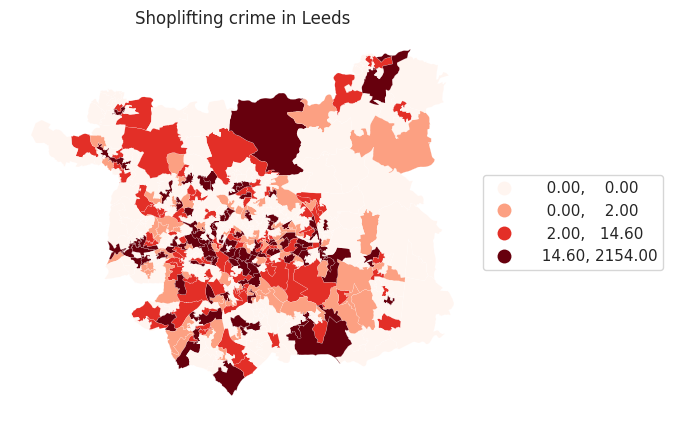

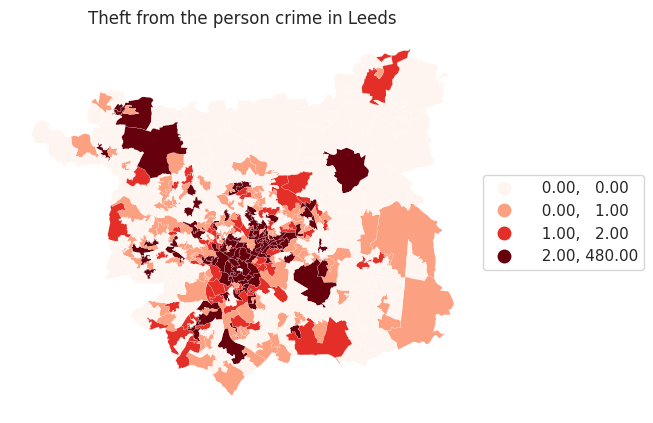

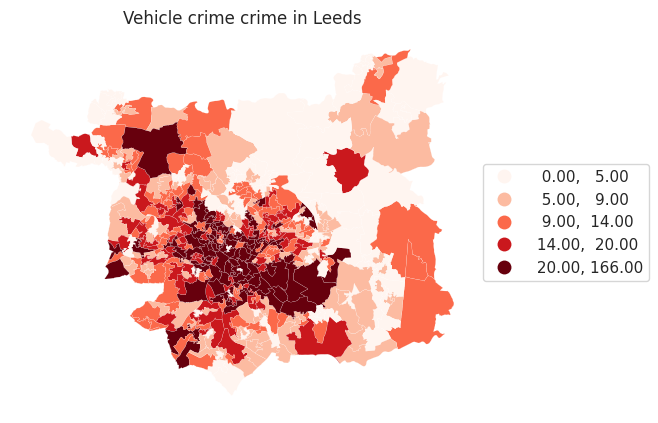

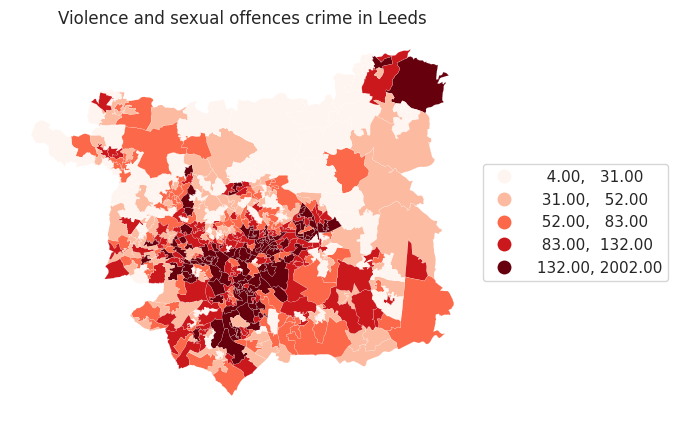

In [26]:
# create a list of the columns we want to plot
crime_cols =['anti-social_behaviour', 'bicycle_theft', 'burglary',
      'criminal_damage_and_arson', 'drugs', 'other_crime',
      'other_theft', 'possession_of_weapons', 'public_order',
      'robbery', 'shoplifting', 'theft_from_the_person',
      'vehicle_crime', 'violence_and_sexual_offences']

# create a for loop for plotting a map of each domain
# this saves writing out 14 blocks of code for each visualisation

# for each item in a range from 0 to 14 (number of items in the crime_cols list)
for i in range (0, len(crime_cols)):

    # produce a plot
    fig, ax = plt.subplots(1, 1, figsize=(6, 6))

    # get the ith item in the decile column list and plot
    leeds_crime_with_ppfi.plot(column=crime_cols[i],


    #### format the plot ###

    # reduce linewidth between polygons
    linewidth=0.1,
    # show the legend
    legend=True,
    # define the legend palette
    cmap='Reds',
    # use the define axis
    ax=ax,
    # postion the legend
    legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5)},
    # use quantiles scheme
    scheme='quantiles')

    # add a title based on the column plotted, formatting the title to look better
    plt.title(crime_cols[i].replace('_',' ').capitalize()+' crime in Leeds')

    # do not plot with the axis showing
    plt.axis('off')

    # save the figure as an image with name reflecting the domain plotted
    plt.savefig(str(crime_cols[i])+'_'+'Leeds'+'.jpg',bbox_inches='tight');

### Explore the association between crime type and PPFI domains using Spearman's rank correlation

#### **Justification of chosen mode (Spearman's rank correlation)**
Based on [Wikipedia](https://en.wikipedia.org/wiki/Spearman%27s_rank_correlation_coefficient), the Spearman correlation between two variables will be high when observations have a similar rank between the two variables, and low when observations have a dissimilar rank between the two variables.

Our objective is to investigate the correlation between PPFI domains and crime. Therefore, **if a correlation between a PPFI domain and a type of crime has a high value, it suggests that a higher domain score is associated with an increased likelihood of that particular type of crime occurring. Vice versa.**




In [27]:
# create a list of the crime columns we want to plot
crime_cols =['anti-social_behaviour', 'bicycle_theft', 'burglary',
      'criminal_damage_and_arson', 'drugs', 'other_crime',
      'other_theft', 'possession_of_weapons', 'public_order',
      'robbery', 'shoplifting', 'theft_from_the_person',
      'vehicle_crime', 'violence_and_sexual_offences']

# create a list of PPFI columns we want to correlate with crime data
ppfi_cols = ['domain_supermarket_proximity',
       'domain_supermarket_accessibility', 'domain_ecommerce_access',
       'domain_socio_demographic', 'domain_nonsupermarket_proximity',
       'domain_food_for_families', 'domain_fuel_poverty']

# create a crime/ppfi series list
crime_ppfi_series_list = []

# create a for loop to append result to crime/ppfi series list
for crime_col in crime_cols:

  # create corr column list
  corr_list = ppfi_cols + [crime_col]

  # compute the corr with spearman method
  ppfi_crime_corr =leeds_crime_with_ppfi[corr_list].corr(method = 'spearman')

  # get the crime/ppfi series
  crime_ppfi_series = ppfi_crime_corr.iloc[-1]

  # delete the last item of the series since it is crime_col itself
  crime_ppfi_series = crime_ppfi_series[:-1]

  # save the crime series to list
  crime_ppfi_series_list.append(crime_ppfi_series)

# concatenate series into a DataFrame and switch columns and index
ppfi_crime_corr_df = pd.concat(crime_ppfi_series_list, axis=1).T

# check data
ppfi_crime_corr_df

,domain_supermarket_proximity,domain_supermarket_accessibility,domain_ecommerce_access,domain_socio_demographic,domain_nonsupermarket_proximity,domain_food_for_families,domain_fuel_poverty
anti-social_behaviour,0.310559,0.244939,-0.360156,-0.529248,0.227489,-0.152219,-0.438689
bicycle_theft,0.364390,0.286512,-0.104735,-0.397981,0.318260,-0.328642,-0.362418
burglary,0.324696,0.296276,-0.197786,-0.503240,0.256721,-0.203030,-0.446449
criminal_damage_and_arson,0.394977,0.296439,-0.497271,-0.742931,0.332629,-0.210040,-0.651351
drugs,0.358400,0.277138,-0.418108,-0.641316,0.327030,-0.290950,-0.607398
other_crime,0.329093,0.173530,-0.521907,-0.604383,0.289429,-0.199574,-0.500782
other_theft,0.406901,0.308539,-0.287583,-0.567270,0.360041,-0.357576,-0.503253
possession_of_weapons,0.363945,0.282901,-0.439762,-0.585376,0.270231,-0.235044,-0.476844
public_order,0.440992,0.311618,-0.471583,-0.690571,0.332521,-0.218520,-0.579697
robbery,0.359454,0.301031,-0.235248,-0.536087,0.337877,-0.318117,-0.492708


#### Visualise the Spearman's rank correlation of the PPFI domains with crime type

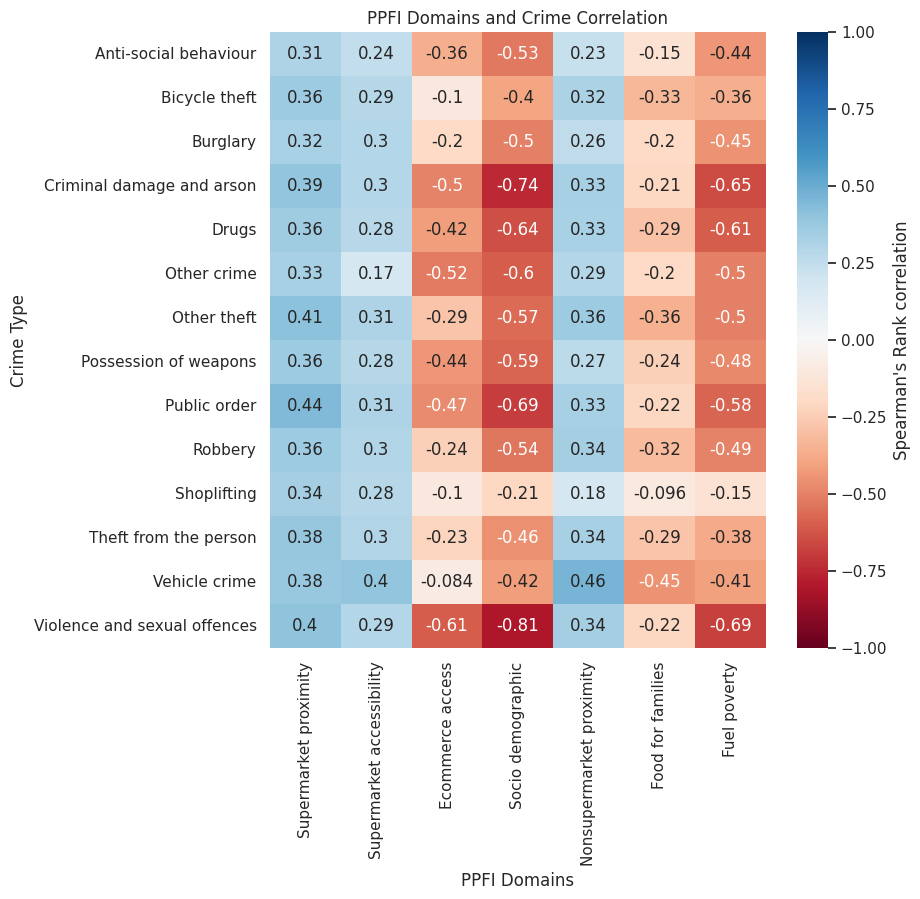

In [28]:
# define plot size
fig,ax = plt.subplots(figsize=(8,8))

# define axis tick labels
# get the columns, replace the underscores with spaces and remove 'domain ' from the name
x_axis_labels = ppfi_crime_corr_df.columns.str.replace('_',' ').str.replace('domain ','')
# get the index, replace the underscores with spaces
y_axis_labels = ppfi_crime_corr_df.index.str.replace('_',' ')

# If we want to capitalize each tick label
# for each element in the list of x_axis_labels, capitalize it
x_axis_labels = [element.capitalize() for element in x_axis_labels]
y_axis_labels = [element.capitalize() for element in y_axis_labels]


# plot a heatmap of the correlation dataframe
sns.heatmap(ppfi_crime_corr_df,
            # annotate so spearman's rank correlation values are displayed on the squares
            annot=True,
            # define colourmap
            cmap='RdBu',
            # define value of minimum colour on cbar
            vmin=-1,
            # define value of maximum colour on cbar
            vmax=1,
            # use the custom tick labels
            xticklabels=x_axis_labels,
            yticklabels=y_axis_labels,
            # add a label to the cbar
            cbar_kws={'label': "Spearman's Rank correlation"},
            # plot on the axis we defined
            ax=ax)

# Set axis labels
ax.set(xlabel="PPFI Domains",
       ylabel="Crime Type",
      title ='PPFI Domains and Crime Correlation' );
plt.savefig('PPFI_Crime_Correlation.png')

#### **Interpret Spearman's rank correlation result**

Socio-demographic status and fuel poverty are the two primary factors
influencing the likelihood of crime. Higher levels of these factors correlate with a decreased likelihood of all types of crime occurring.

The result is logical. A higher socio-demographic status typically corresponds to higher income, greater levels of education, and increased rates of employment. Therefore, it is reasonable to expect lower crime rates in such areas.

It's also intriguing that a higher socio-demographic status correlates most strongly with reductions in "violence and sexual offenses" and "criminal damage and arson."




# K-means Clustering Analysis

Now let's try to explore the cluster distribution of crimes in Leeds

## Identify the number of clusters using the elbow method

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

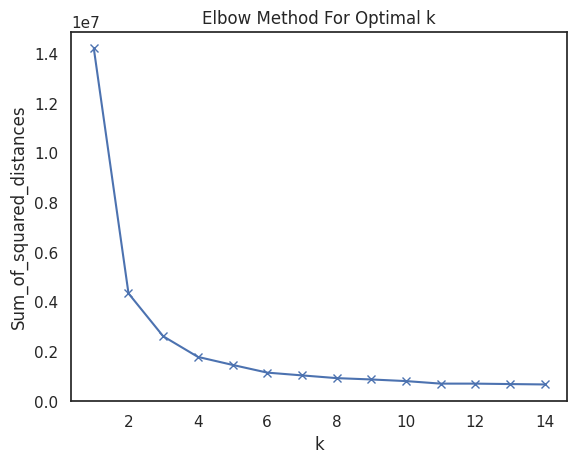

In [29]:
# create a list of the crime columns we want to plot
crime_cols =['anti-social_behaviour', 'bicycle_theft', 'burglary',
      'criminal_damage_and_arson', 'drugs', 'other_crime',
      'other_theft', 'possession_of_weapons', 'public_order',
      'robbery', 'shoplifting', 'theft_from_the_person',
      'vehicle_crime', 'violence_and_sexual_offences']

# create an empty list to fill with values later
Sum_of_squared_distances = []

# get a range of numbers from 1 to 15
K = range(1,15)
#for each number in the range 1 to 15
for k in K:
    # create a k-means model with that number of clusters
    # set random state
    km = cluster.KMeans(n_clusters=k, init="random", random_state=12345678)
    # fit the model using the variables of interest (in this case the 7 PPFI domain deciles + 14 crime)
    km = km.fit(leeds_crime_with_ppfi[crime_cols].values)
    # calculate the sum of the squared distances and add this to the 'Sum_of_squared_distances' list we created earlier
    Sum_of_squared_distances.append(km.inertia_)

# plot the sum of squared distances against the number of clusters
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

It sounds **4** clusters does not substantively reduce the sum of squared distances.

## Run the K-means model with N=4 clusters

In [30]:
# create a list of the crime columns we want to plot
crime_cols =['anti-social_behaviour', 'bicycle_theft', 'burglary',
      'criminal_damage_and_arson', 'drugs', 'other_crime',
      'other_theft', 'possession_of_weapons', 'public_order',
      'robbery', 'shoplifting', 'theft_from_the_person',
      'vehicle_crime', 'violence_and_sexual_offences']

# run the model with 5 clusters
km5 = cluster.KMeans(n_clusters=4,init="random", random_state=12345678)
km5cls = km5.fit(leeds_crime_with_ppfi[crime_cols].values)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


### Create a new column with the cluster label



In [31]:
# copy leeds_crime_with_ppfi
leeds_crime_with_ppfi_and_cluster = leeds_crime_with_ppfi.copy()

# add a new "cluster" column
leeds_crime_with_ppfi_and_cluster['cluster'] = km5cls.labels_

### Explore the clustering result

Map the clusters to view any spatial relationship(s) between clusters


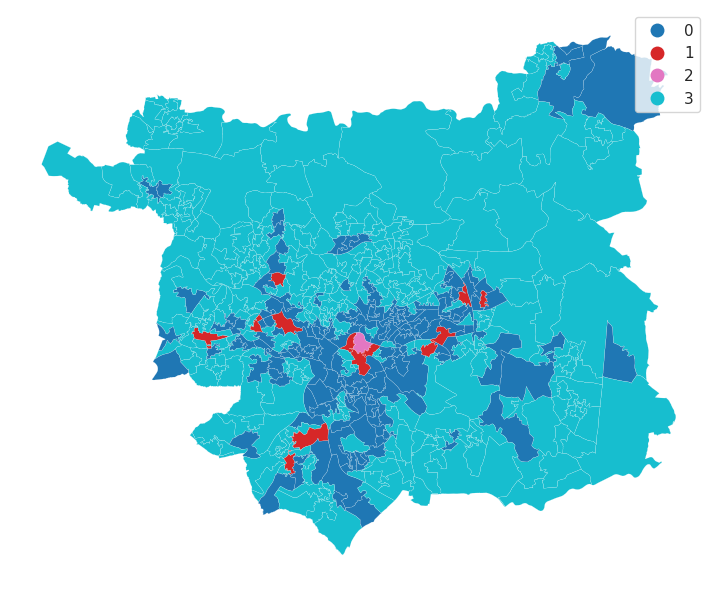

In [32]:
# We can also see that there is a spatial pattern to the clusters when we map them
f, ax = plt.subplots(1, figsize=(9, 9))

leeds_crime_with_ppfi_and_cluster.plot(column='cluster', categorical=True, legend=True, \
         linewidth=0.1, edgecolor='white', ax=ax)

ax.set_axis_off()

plt.show()

### Calculate summary statistics to compare clusters

In [33]:
# create a list of the crime columns we want to plot
crime_cols = ['anti-social_behaviour', 'bicycle_theft', 'burglary',
      'criminal_damage_and_arson', 'drugs', 'other_crime',
      'other_theft', 'possession_of_weapons', 'public_order',
      'robbery', 'shoplifting', 'theft_from_the_person',
      'vehicle_crime', 'violence_and_sexual_offences']

# use groupby to get the median decile value of each PPFI domain by cluster
leeds_crime_clusters_median = leeds_crime_with_ppfi_and_cluster.groupby('cluster')[crime_cols].median().reset_index()

# check result
leeds_crime_clusters_median

,cluster,anti-social_behaviour,bicycle_theft,burglary,criminal_damage_and_arson,drugs,other_crime,other_theft,possession_of_weapons,public_order,robbery,shoplifting,theft_from_the_person,vehicle_crime,violence_and_sexual_offences
0,0,25.5,2.0,15.0,31.0,7.0,9.0,18.0,3.0,32.0,4.0,3.0,2.0,16.0,137.0
1,1,34.0,4.0,19.0,46.0,8.0,13.0,46.0,5.0,65.0,6.0,247.0,4.0,30.0,193.0
2,2,384.0,170.0,290.0,280.0,206.0,87.0,668.0,51.0,763.0,216.0,2154.0,480.0,166.0,2002.0
3,3,8.0,0.0,8.0,8.0,2.0,3.0,6.0,0.0,10.0,1.0,0.0,0.0,9.0,44.0


In [34]:
# create a list of the crime columns we want to plot
crime_cols = ['anti-social_behaviour', 'bicycle_theft', 'burglary',
      'criminal_damage_and_arson', 'drugs', 'other_crime',
      'other_theft', 'possession_of_weapons', 'public_order',
      'robbery', 'shoplifting', 'theft_from_the_person',
      'vehicle_crime', 'violence_and_sexual_offences']

# let's transform the data from a 'wide' format to a 'long' format to plot
leeds_crime_clusters_median_to_plot = pd.melt(leeds_crime_clusters_median, id_vars='cluster', value_vars=crime_cols)

# rename columns ot be more intuitive
leeds_crime_clusters_median_to_plot.columns = ['Cluster','Crime','Median']

# check data
leeds_crime_clusters_median_to_plot.head()

,Cluster,Crime,Median
0,0,anti-social_behaviour,25.5
1,1,anti-social_behaviour,34.0
2,2,anti-social_behaviour,384.0
3,3,anti-social_behaviour,8.0
4,0,bicycle_theft,2.0


### Visualise Cluster by average (median) domain values

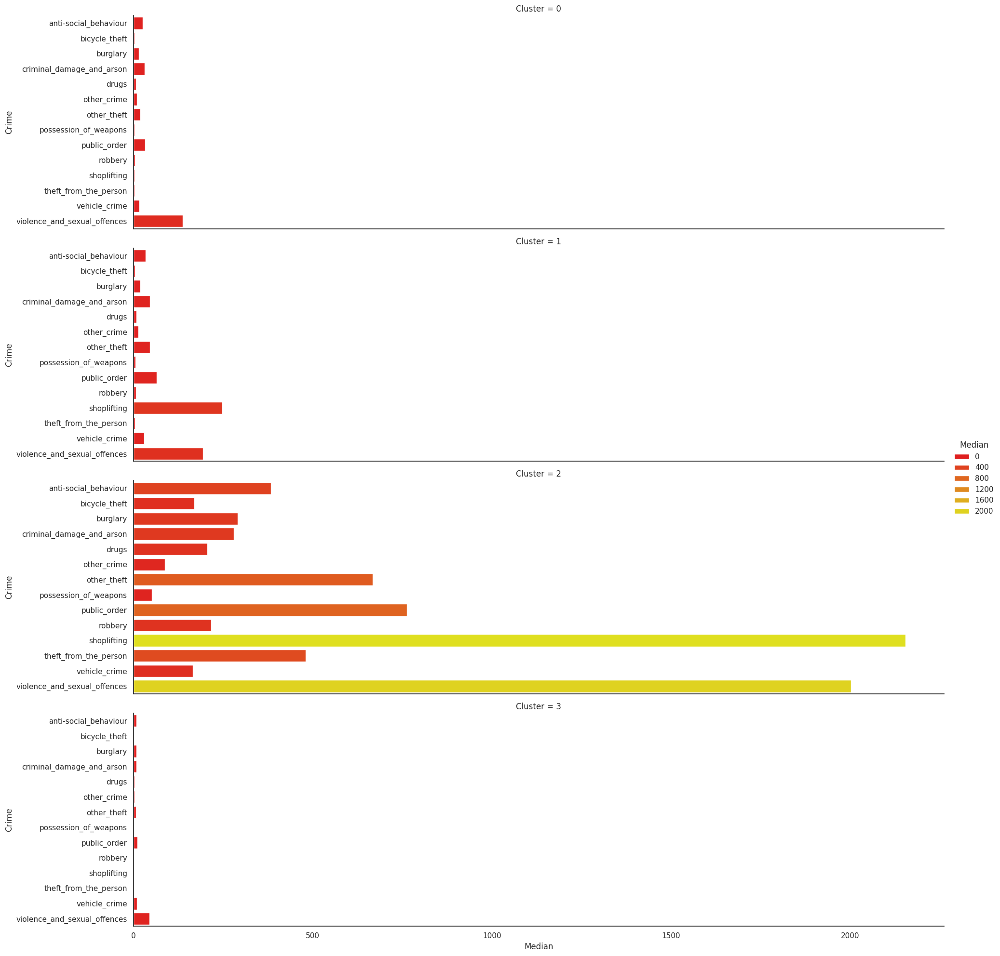

In [35]:
# Plot a faceted bar chart, where each row is a different cluster

sns.catplot(leeds_crime_clusters_median_to_plot,
            row='Cluster',
            y='Crime',
            x='Median',
            kind='bar',
            aspect=4,
            hue='Median',
            palette='autumn')
plt.savefig('cluster_crime_overview.png')

### Name clusters using generated cluster summaries

In [36]:
# edit to add your cluster descriptions
leeds_crime_with_ppfi_and_cluster.loc[leeds_crime_with_ppfi_and_cluster['cluster']==0,'cluster_description']='Mainly violence and sexual offences'
leeds_crime_with_ppfi_and_cluster.loc[leeds_crime_with_ppfi_and_cluster['cluster']==1,'cluster_description']='Mainly shoplifting'
leeds_crime_with_ppfi_and_cluster.loc[leeds_crime_with_ppfi_and_cluster['cluster']==2,'cluster_description']='Crime hotspot'
leeds_crime_with_ppfi_and_cluster.loc[leeds_crime_with_ppfi_and_cluster['cluster']==3,'cluster_description']='Peaceful haven'

### Visualise Cluster Description

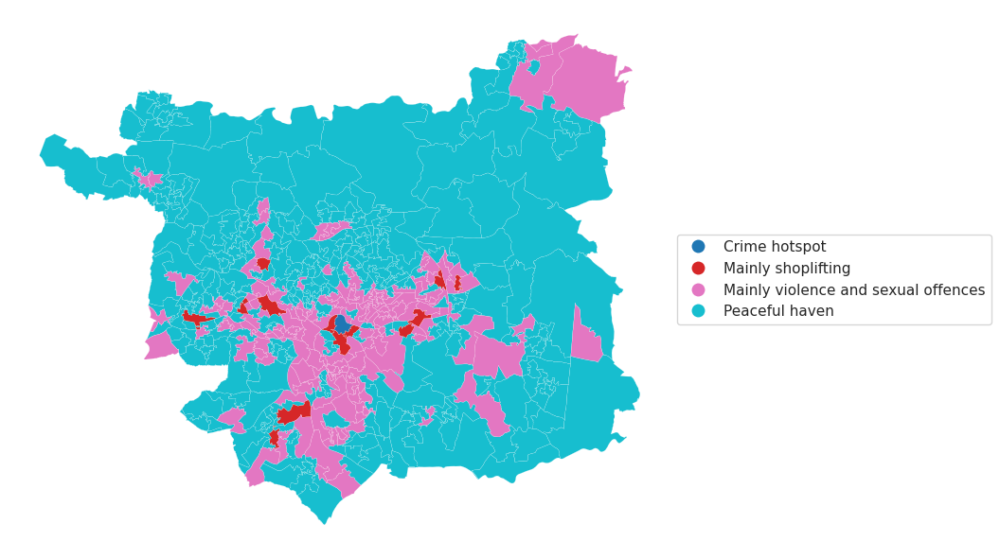

In [37]:
# We can also see that there is a spatial pattern to the clusters when we map them
f, ax = plt.subplots(1, figsize=(9, 9))

leeds_crime_with_ppfi_and_cluster.plot(column='cluster_description', categorical=True, legend=True, \
         linewidth=0.1, edgecolor='white', ax=ax,
    legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5)})

ax.set_axis_off()

plt.show()

In [38]:
# use hex colours to define my own cmap,
my_cmap=['#D62728','#1F77B4','#E377C2','#17BECF']

# Plot your cluster descriptions on the map
map = leeds_crime_with_ppfi_and_cluster.sort_values('cluster_description').explore('cluster_description', categorical=True, cmap=my_cmap)

# save to html file
map.save("leeds_crime_cluster_map.html")

# view map
map

### **Crime Cluster Map Analysis**

The crime cluster above indicates that most areas of Leeds are relatively safe, with the exception of LSOA code E01033010 (Leeds 111B), which stands out as a significant crime hotspot. Additionally, there are a few areas in the central and northeastern parts of Leeds that experience notable occurrences of violence and sexual offenses, as well as shoplifting crimes.

# Conclusion



## PPFI Domains and Crime Spearman Correlation

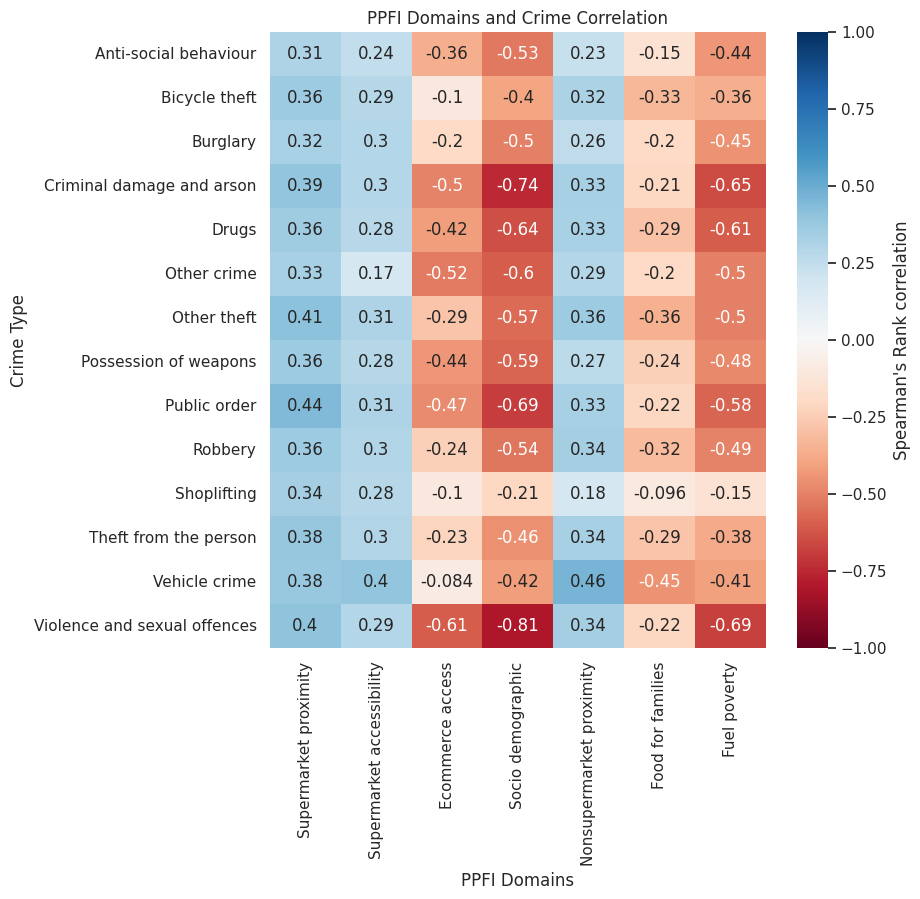

Socio-demographic status and fuel poverty are the two primary factors
influencing the likelihood of crime. Higher levels of these factors correlate with a decreased likelihood of all types of crime occurring.

The result is logical. A higher socio-demographic status typically corresponds to higher income, greater levels of education, and increased rates of employment. Therefore, it is reasonable to expect lower crime rates in such areas.

It's also intriguing that a higher socio-demographic status correlates most strongly with reductions in "violence and sexual offenses" and "criminal damage and arson."

## Crime Cluster Map

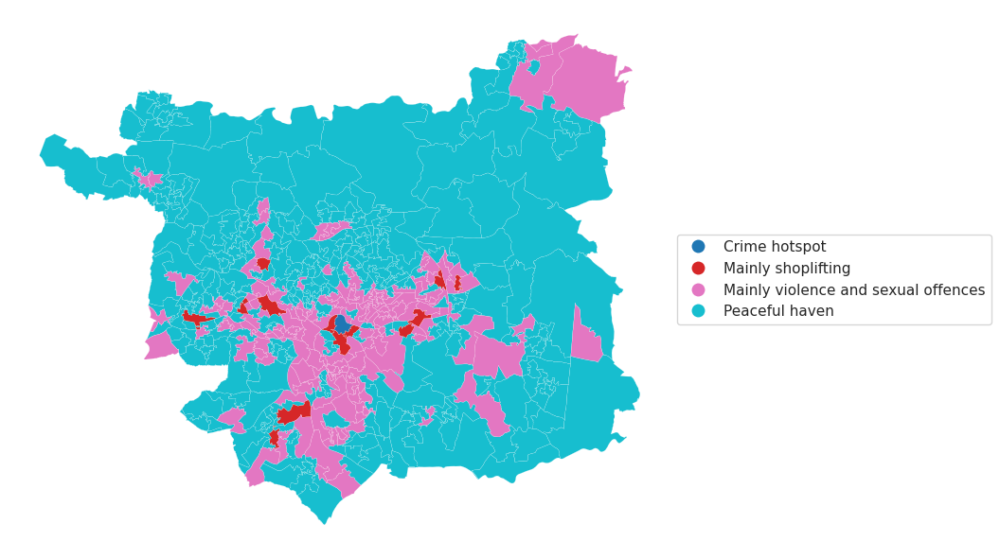

The crime cluster above indicates that most areas of Leeds are relatively safe, with the exception of LSOA code E01033010 (Leeds 111B), which stands out as a significant crime hotspot. Additionally, there are a few areas in the central and northeastern parts of Leeds that experience notable occurrences of violence and sexual offenses, as well as shoplifting crimes.